In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
import pandas as pd
import numpy as np

from scipy.stats import describe

from skimage.segmentation import quickshift, mark_boundaries 
from skimage.draw import polygon, polygon_perimeter
from skimage import measure
from skimage import io

from matplotlib.patches import Circle, Polygon
import matplotlib.pyplot as plt
import matplotlib.cm as cm

from ipywidgets import interact, fixed
from os import listdir

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [ ]:
raw_data_1 = ('3385780/polygonDataExceptVertices.csv')
raw_data_2 = ('3385780/polygonVertices_PixelCoordinates.csv')

arrays = pd.read_csv(raw_data_1)
vertices_pix = pd.read_csv(raw_data_2)

In [ ]:
arrays.head()

,Unnamed: 0,polygon_id,centroid_latitude,centroid_longitude,centroid_latitude_pixels,centroid_longitude_pixels,city,area_pixels,area_meters,image_name,nw_corner_of_image_latitude,nw_corner_of_image_longitude,se_corner_of_image_latitude,se_corner_of_image_longitude,datum,projection_zone,resolution,jaccard_index
0,0,1,36.926310,-119.840555,107.618458,3286.151487,Fresno,1513.254134,136.192872,11ska460890,36.926336,-119.851622,36.913233,-119.8343,NAD83,11,0.3,0.914020
1,1,2,36.926477,-119.840561,45.977659,3286.352946,Fresno,1727.907934,155.511714,11ska460890,36.926336,-119.851622,36.913233,-119.8343,NAD83,11,0.3,0.829071
2,2,3,36.926542,-119.840506,22.280851,3303.465657,Fresno,1242.184349,111.796591,11ska460890,36.926336,-119.851622,36.913233,-119.8343,NAD83,11,0.3,0.937961
3,3,4,36.921008,-119.842847,2048.362567,2547.366116,Fresno,688.933420,62.004008,11ska460890,36.926336,-119.851622,36.913233,-119.8343,NAD83,11,0.3,0.842634
4,4,5,36.920976,-119.842906,2060.014890,2529.504997,Fresno,1060.890554,95.480150,11ska460890,36.926336,-119.851622,36.913233,-119.8343,NAD83,11,0.3,0.890998


In [ ]:
vertices_pix.head()

,polygon_id,number_vertices,3_1,3_2,3_3,3_4,3_5,3_6,3_7,3_8,...,3_283,3_284,3_285,3_286,3_287,3_288,3_289,3_290,3_291,3_292
0,1,8,131.631164,3360.495069,87.985141,3249.197710,73.850000,3213.750000,81.950000,3210.450000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2,9,69.615385,3361.153846,12.846154,3217.615385,13.096107,3217.440417,12.450000,3215.850000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,3,11,48.136863,3358.015726,48.150000,3358.050000,42.379290,3360.742998,39.467456,3362.122288,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,4,9,2068.049310,2571.591716,2067.393899,2571.021266,2067.150000,2571.350000,2021.550000,2531.150000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,5,9,2091.398422,2563.781065,2021.674556,2504.416174,2022.048728,2503.979640,2021.550000,2503.550000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# Function to clean polygon vertices data 

def extract_vertices(df):
    
    # Create melted version of vertices_pix dataframe and clean
    pix = pd.melt(df, id_vars=['polygon_id','number_vertices'])
    pix = pix.dropna()
    pix['value'] = pix['value'].map(lambda x: int(round(x)))
    pix['pixel_id'] = pix['variable'].map(lambda x: int(x.replace(' ','').split('_')[1]))
    pix.drop('variable', axis=1, inplace=True)
    
    # Assign each row with the pair it belongs to 
    pairs = zip(range(1,292,2), range(2,293,2))
    pairs = [pair for double in zip(pairs, pairs) for pair in double]    
    pix['pair'] = pix['pixel_id'].map(lambda x: pairs[x - 1])
    
    # Seperate odd/even and merge together
    even = pix[(pix['pixel_id'] % 2 == 0)]
    odd = pix[~(pix['pixel_id'] % 2 == 0)]
    
    pix_merge = odd.merge(even, on=['polygon_id','number_vertices','pair'])
    pix_merge['coordinate'] = map(lambda x, y: (x, y), pix_merge['value_x'].values, pix_merge['value_y'].values)
    
    # Recombine all coordinate pairs by polygon id 
    polygon_coords = pix_merge[['polygon_id','coordinate']]
    polygon_coords = pd.pivot_table(polygon_coords, index='polygon_id', values='coordinate',
                                aggfunc=lambda x: x.values.tolist())
    
    polygon_coords = polygon_coords.reset_index()
    polygon_coords.columns = ['polygon_id','polygon_vertices']
    
    return polygon_coords

In [ ]:
vertices_pix_clean = extract_vertices(vertices_pix)

In [ ]:
vertices_pix_clean.head()

,polygon_id,polygon_vertices
0,1,"[(132, 3360), (88, 3249), (74, 3214), (82, 321..."
1,2,"[(70, 3361), (13, 3218), (13, 3217), (12, 3216..."
2,3,"[(48, 3358), (48, 3358), (42, 3361), (39, 3362..."
3,4,"[(2068, 2572), (2067, 2571), (2067, 2571), (20..."
4,5,"[(2091, 2564), (2022, 2504), (2022, 2504), (20..."


In [ ]:
arrays_clean = arrays.merge(vertices_pix_clean, how='inner', on='polygon_id')
arrays_clean = arrays_clean[['polygon_id', 'centroid_latitude_pixels', 'centroid_longitude_pixels', 'city', 
                            'image_name', 'polygon_vertices']]

In [ ]:
arrays_clean.head()

,polygon_id,centroid_latitude_pixels,centroid_longitude_pixels,city,image_name,polygon_vertices
0,1,107.618458,3286.151487,Fresno,11ska460890,"[(132, 3360), (88, 3249), (74, 3214), (82, 321..."
1,2,45.977659,3286.352946,Fresno,11ska460890,"[(70, 3361), (13, 3218), (13, 3217), (12, 3216..."
2,3,22.280851,3303.465657,Fresno,11ska460890,"[(48, 3358), (48, 3358), (42, 3361), (39, 3362..."
3,4,2048.362567,2547.366116,Fresno,11ska460890,"[(2068, 2572), (2067, 2571), (2067, 2571), (20..."
4,5,2060.014890,2529.504997,Fresno,11ska460890,"[(2091, 2564), (2022, 2504), (2022, 2504), (20..."


In [ ]:
arrays_clean.to_csv("raw_Data.csv")

In [ ]:
arrays_clean = pd.read_csv("raw_Data.csv")

In [ ]:
arrays_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 19433 entries, 0 to 19432
Data columns (total 6 columns):
polygon_id                   19433 non-null int64
centroid_latitude_pixels     19433 non-null float64
centroid_longitude_pixels    19433 non-null float64
city                         19433 non-null object
image_name                   19433 non-null object
polygon_vertices             19433 non-null object
dtypes: float64(2), int64(1), object(3)
memory usage: 1.0+ MB


In [ ]:

# Count of array annotations and satellite images for each city in the dataset

poly_agg = arrays_clean.groupby(['city','image_name'])[['polygon_id']].count().reset_index()
array_agg = poly_agg.groupby('city')[['image_name']].count().reset_index()
array_agg = array_agg.merge(poly_agg.groupby('city')[['polygon_id']].sum().reset_index())
array_agg = array_agg.sort_values(by='image_name', ascending=False)
array_agg

,city,image_name,polygon_id
0,Fresno,310,14710
3,Stockton,85,2546
2,Oxnard,50,1595
1,Modesto,18,582


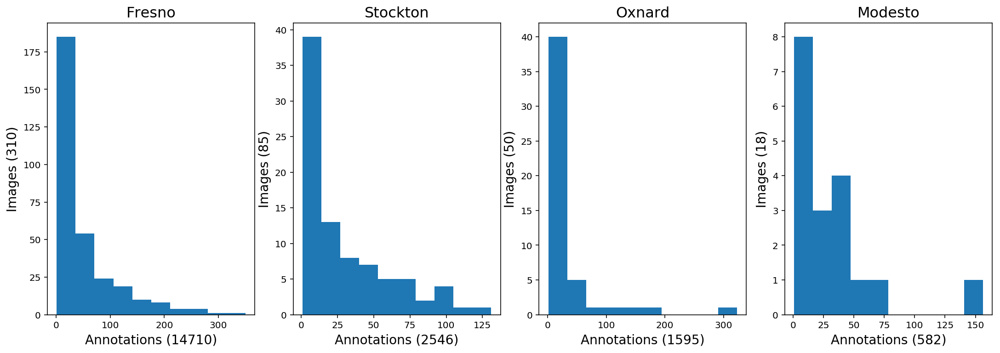

In [ ]:
# Distribution of annotations per image, by city 

cities = array_agg['city'].unique()

fig, ax = plt.subplots(1, len(cities), figsize=(15,5))
fig.tight_layout()

for i, city in enumerate(cities):
    annotations = array_agg[array_agg['city'] == city]['polygon_id'].values[0]
    images = array_agg[array_agg['city'] == city]['image_name'].values[0]
    
    ax[i].hist(arrays[arrays['city'] == city]['image_name'].value_counts())
    ax[i].set_title(city, fontsize=16)
    
    ax[i].set_xlabel('Annotations (' + str(annotations) + ')', fontsize=14)
    ax[i].set_ylabel('Images (' + str(images) + ')', fontsize=14)

In [ ]:
# Plot centers of all solar arrays for a given satellite image

def plot_centroids(img_id):
    
    # Use img_id to create path to correct directory 
    city = arrays_clean[arrays_clean['image_name'] == img_id]['city'].values[0]
    
    # Read in image
    img = io.imread('%s/%s.tif' % (city, img_id), plugin='pil')
    
    # Extract centroid coordinates from dataframe    
    arrays_sub = arrays_clean[arrays_clean['image_name'] == img_id]
    coordinates = zip(list(arrays_sub['centroid_longitude_pixels']),
                      list(arrays_sub['centroid_latitude_pixels']))

    # Display image
    fig,ax = plt.subplots(figsize=(12, 12))

    ax.imshow(img[:,:,1], cmap=cm.gray)
    
    # Plot a circle for each solar panel array
    for x, y in coordinates:
        centroid = Circle((x, y), 20, color='blue')
        ax.add_patch(centroid)

In [ ]:
# Plot polygon outline for a given solar panel array

def plot_polygon(poly_id):
     
    # Use poly_id to identify image name and create path to correct directory 
    img_id = arrays_clean[arrays_clean['polygon_id'] == poly_id]['image_name'].values[0]
    city = arrays_clean[arrays_clean['image_name'] == img_id]['city'].values[0]
        
    # Extract polygon vertices from dataframe, calculate min/max
    vertices = arrays_clean[arrays_clean['polygon_id'] == poly_id][['polygon_vertices']].iloc[0,0]
    
    x_values = [x[0] for x in vertices]
    y_values = [y[1] for y in vertices]
    x_min, x_max = min(x_values), max(x_values) 
    y_min, y_max = min(y_values), max(y_values)

    # Read in image, crop   
    img = io.imread('%s/%s.tif' % (city, img_id), plugin='pil')
    band = 10
    img_cropped = img[x_min - band : x_max + band, 
                      y_min - band : y_max + band]
                      

    # Display cropped image
    fig,ax = plt.subplots()

    ax.imshow(img_cropped)

    # Plot a polygon for each solar panel array. Vertices must be flipped to conform to 'Polygon' convention
    resized_coords = [(y - (y_min - band) - 1, x - (x_min - band) - 1) for x, y in vertices]
    poly = Polygon(resized_coords, fill=False, color='blue')
    ax.add_patch(poly)

In [ ]:
def plot_polygon_image(img_id):
    
    # Use img_id to create path to correct directory 
    city = arrays_clean[arrays_clean['image_name'] == img_id]['city'].values[0]
    
    # Read in image
    img = io.imread('%s/%s.tif' % (city, img_id), plugin='pil')
    
    # Extract centroid coordinates from dataframe    
    # arrays_sub = arrays_clean[arrays_clean['image_name'] == img_id]
    # coordinates = zip(list(arrays_sub['centroid_longitude_pixels']),
    #                   list(arrays_sub['centroid_latitude_pixels']))
    poly_list = arrays_clean[arrays_clean['image_name'] == img_id]['polygon_id'].values
    fig,ax = plt.subplots(figsize=(24, 24))
    img_cropped = img[:,:] 
    ax.imshow(img_cropped)

    for poly in poly_list[:]:
      img_id = arrays_clean[arrays_clean['polygon_id'] == poly]['image_name'].values[0]
      # city = arrays_clean[arrays_clean['image_name'] == img_id]['city'].values[0]
          
      # Extract polygon vertices from dataframe, calculate min/max
      vertices = arrays_clean[arrays_clean['polygon_id'] == poly][['polygon_vertices']].iloc[0,0]
      # print(vertices)
      
      # x_values = [x[0] for x in vertices]
      # y_values = [y[1] for y in vertices]
      # x_min, x_max = min(x_values), max(x_values) 
      # y_min, y_max = min(y_values), max(y_values)           

      # Plot a polygon for each solar panel array. Vertices must be flipped to conform to 'Polygon' convention
      # for x,y in vertices:
      resized_coords = [(y, x) for x, y in vertices]
      poly = Polygon(resized_coords, fill=True, color='blue')
      ax.add_patch(poly)

    # Display image
    # fig,ax = plt.subplots(figsize=(12, 12))

    # ax.imshow(img[:,:,1], cmap=cm.gray)
    
    # # Plot a circle for each solar panel array
    # for x, y in coordinates:
    #     centroid = Circle((x, y), 20, color='blue')
    #     ax.add_patch(centroid)

3385780        Fresno				model.png  Oxnard
dataset.ipynb  image_segmentation_github.ipynb	Modesto    Stockton


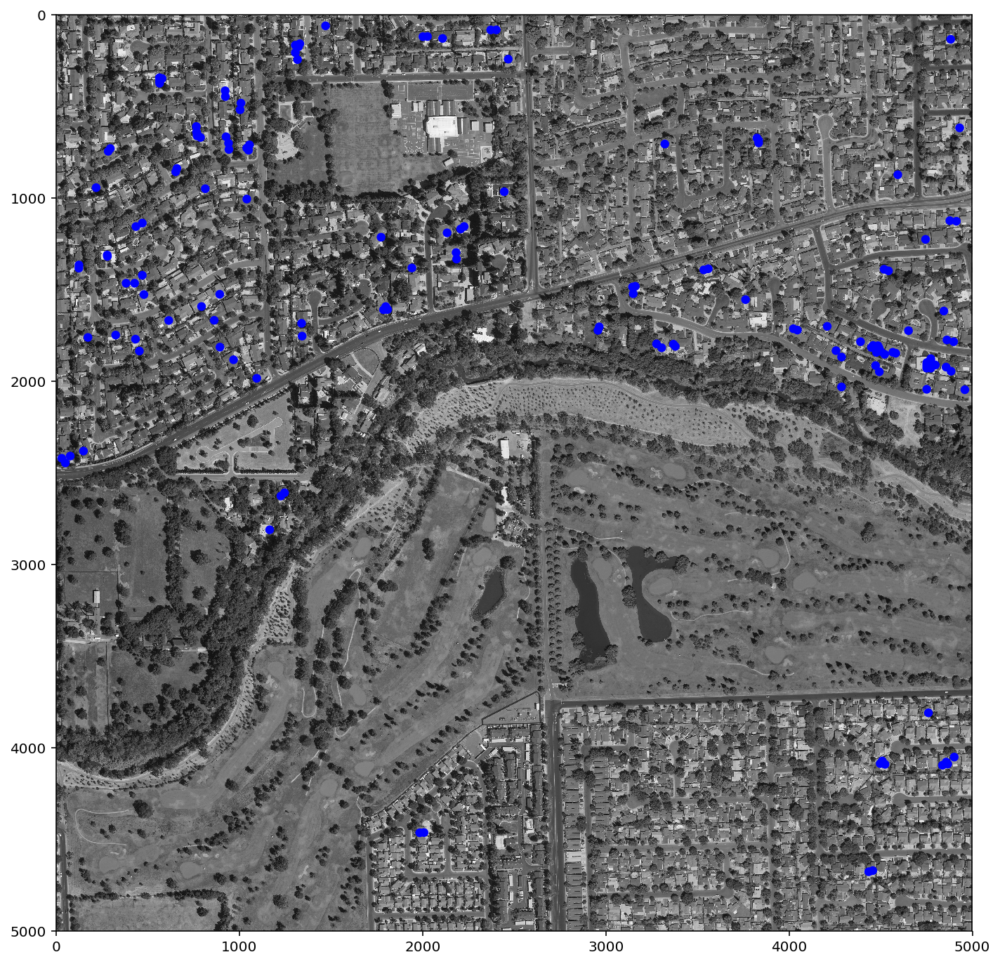

In [ ]:
!ls
plot_centroids('10sfg810685')

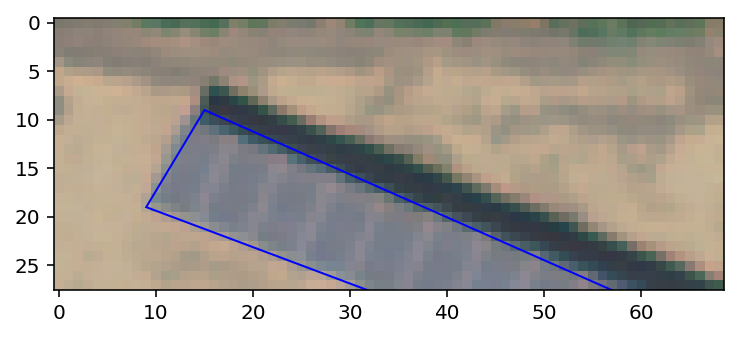

In [ ]:
poly_list = arrays_clean[arrays_clean['image_name'] != '10sfh420075']['polygon_id'].values

for poly in poly_list[8:9]:
    plot_polygon(poly)

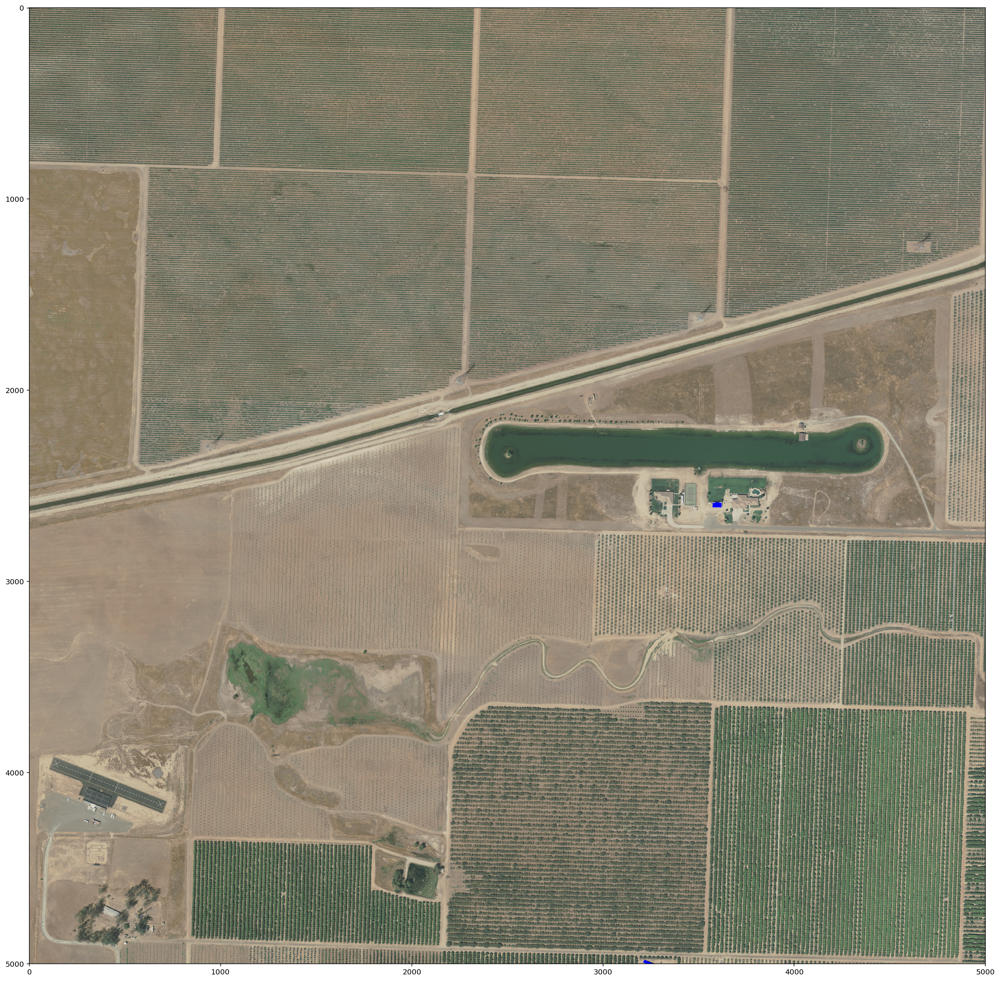

In [ ]:
plot_polygon_image('11ska460905')

In [ ]:
def create_mask(img_id):
   
    # Use img_id to create path to correct directory 
    city = arrays_clean[arrays_clean['image_name'] == img_id]['city'].values[0]
    
    # Read in image
    img = io.imread('%s/%s.tif' % (city, img_id), plugin='pil')
    vertices = arrays_clean[arrays_clean['image_name'] == img_id]['polygon_vertices'].values
    labels = arrays_clean[arrays_clean['image_name'] == img_id]['polygon_id'].values
    mask = np.zeros((img.shape[0],img.shape[1]))
    perimeter = np.zeros((img.shape[0],img.shape[1]))
    mask=mask.astype(np.int8)
    perimeter = perimeter.astype(np.int8)
    
    poly_data = zip(labels, vertices)
    for i, poly in poly_data:
        x = np.array([vert[0] for vert in poly])
        y = np.array([vert[1] for vert in poly])
       
        # mask[polygon(x, y, shape=(img.shape[0],img.shape[1]))] = 1 
        perimeter[polygon_perimeter(x, y,shape=(img.shape[0],img.shape[1]))] = 1
    del img

    return perimeter


In [ ]:
def mask_centroids(poly_id):
  # Use img_id to create path to correct directory 
    img_id = arrays_clean[arrays_clean['polygon_id'] == poly_id]['image_name'].values[0]
    city = arrays_clean[arrays_clean['image_name'] == img_id]['city'].values[0]
    img = io.imread('%s/%s.tif' % (city, img_id), plugin='pil')
    whole_mask, whole_perimeter = create_mask(img_id)
        
  # Extract polygon vertices from dataframe, calculate min/max
    vertices = arrays_clean[arrays_clean['polygon_id'] == poly_id][['polygon_vertices']].iloc[0,0]
    
  # Extract centroid coordinates from dataframe    
    arrays_sub = arrays_clean[arrays_clean['image_name'] == img_id]
  # coordinates = zip(list(arrays_sub['centroid_longitude_pixels']),
  #                     list(arrays_sub['centroid_latitude_pixels']))
    band = 64

    # vertices = arrays_clean[arrays_clean['polygon_id'] == poly_id][['polygon_vertices']].iloc[0,0]
    
    x_values = [x[0] for x in vertices]
    y_values = [y[1] for y in vertices]
    x_min, x_max = min(x_values), max(x_values) 
    y_min, y_max = min(y_values), max(y_values)

    if((int)((0.5*(x_min+x_max)) - band)<=0):
        X_MIN = 0
    else:
        X_MIN = (int)(0.5*(x_min+x_max)) - band
    

    if((int)((0.5*(y_min+y_max)) - band)<=0):
        Y_MIN = 0
    else:
        Y_MIN = (int)(0.5*(y_min+y_max)) - band
    

    if((int)((0.5*(x_min+x_max)) + band)>=img.shape[0]):
        X_MAX = img.shape[0]
    else:
        X_MAX = (int)(0.5*(x_min+x_max)) + band
    

    if((int)((0.5*(y_min+y_max)) + band)>=img.shape[1]):
        Y_MAX = img.shape[1]
    else:
        Y_MAX = (int)(0.5*(y_min+y_max)) + band
    
    if((int)((0.5*(x_min+x_max)) - band)<=0):
      X_MAX-=(int)(0.5*(x_min+x_max)) - band

    if((int)((0.5*(y_min+y_max)) - band)<=0):
      Y_MAX-=(int)(0.5*(y_min+y_max)) - band

    if((int)((0.5*(x_min+x_max)) + band)>=img.shape[0]):
      X_MIN+=img.shape[0]-(int)(0.5*(x_min+x_max)) - band

    if((int)((0.5*(y_min+y_max)) + band)>=img.shape[1]):
      Y_MIN+=img.shape[1]-(int)(0.5*(y_min+y_max)) - band

    mask_cropped = whole_mask[X_MIN : X_MAX, 
                      Y_MIN : Y_MAX]
    perimeter_cropped = whole_perimeter[X_MIN : X_MAX, 
                      Y_MIN : Y_MAX]
    # print(mask_cropped.shape)
    # plt.plot(mask_cropped)
    # plt.imshow(mask_cropped)
    #fig,ax = plt.subplots(figsize=(12, 12))
    #ax.imshow(mask_cropped,cmap='gray')              
    mask_cropped = mask_cropped[:,:,np.newaxis]
    perimeter_cropped = perimeter_cropped[:,:,np.newaxis]
    
    
    del whole_mask
    return mask_cropped, perimeter_cropped
  

In [ ]:
# print(create_mask('10sfg810685').view())
create_mask('10sfg810685')

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

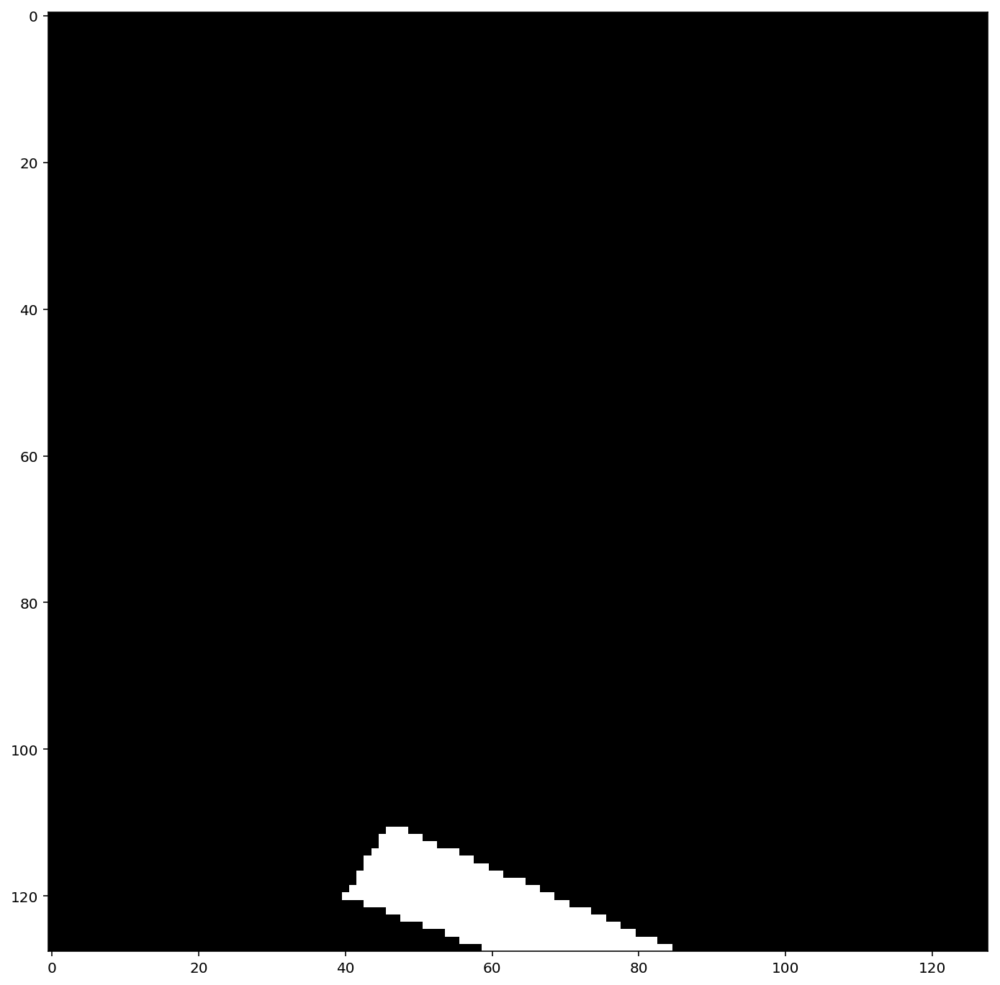

In [ ]:
poly_list = arrays_clean[arrays_clean['image_name'] != '10sfh420075']['polygon_id'].values

for poly in poly_list[8:9]:
  mask_centroids(poly)
  # print(np.sum(mask_centroids(poly)==1))
  # print(mask_centroids(poly))
  # mask_centroids(poly)
  

In [ ]:
from PIL import Image
def create_X_train(poly_id):
     
    # Use poly_id to identify image name and create path to correct directory 
    img_id = arrays_clean[arrays_clean['polygon_id'] == poly_id]['image_name'].values[0]
    city = arrays_clean[arrays_clean['image_name'] == img_id]['city'].values[0]
        
    # Extract polygon vertices from dataframe, calculate min/max
    vertices = arrays_clean[arrays_clean['polygon_id'] == poly_id][['polygon_vertices']].iloc[0,0]
    
    x_values = [x[0] for x in vertices]
    y_values = [y[1] for y in vertices]
    x_min, x_max = min(x_values), max(x_values) 
    y_min, y_max = min(y_values), max(y_values)

    # Read in image, crop   
    img = io.imread('%s/%s.tif' % (city, img_id), plugin='pil')
    img_check=Image.open('%s/%s.tif' % (city, img_id))
    
    if(img_check.mode=="RGBA"):
      img_check = img_check.convert('RGB')
      img = np.array(img_check)

    del img_check
    band = 64

    if((int)((0.5*(x_min+x_max)) - band)<=0):
        X_MIN = 0
    else:
        X_MIN = (int)(0.5*(x_min+x_max)) - band
    

    if((int)((0.5*(y_min+y_max)) - band)<=0):
        Y_MIN = 0
    else:
        Y_MIN = (int)(0.5*(y_min+y_max)) - band
    

    if((int)((0.5*(x_min+x_max)) + band)>=img.shape[0]):
        X_MAX = img.shape[0]
    else:
        X_MAX = (int)(0.5*(x_min+x_max)) + band
    

    if((int)((0.5*(y_min+y_max)) + band)>=img.shape[1]):
        Y_MAX = img.shape[1]
    else:
        Y_MAX = (int)(0.5*(y_min+y_max)) + band
    
    if((int)((0.5*(x_min+x_max)) - band)<=0):
      X_MAX-=(int)(0.5*(x_min+x_max)) - band

    if((int)((0.5*(y_min+y_max)) - band)<=0):
      Y_MAX-=(int)(0.5*(y_min+y_max)) - band

    if((int)((0.5*(x_min+x_max)) + band)>=img.shape[0]):
      X_MIN+=img.shape[0]-(int)(0.5*(x_min+x_max)) - band

    if((int)((0.5*(y_min+y_max)) + band)>=img.shape[1]):
      Y_MIN+=img.shape[1]-(int)(0.5*(y_min+y_max)) - band

    
    img_cropped = img[X_MIN : X_MAX, 
                      Y_MIN : Y_MAX]
          
    fig,ax = plt.subplots(figsize=(12, 12))
    ax.imshow(img_cropped)

    # Display cropped image
    X = np.array(img_cropped)
    del img
    del img_cropped
    return X

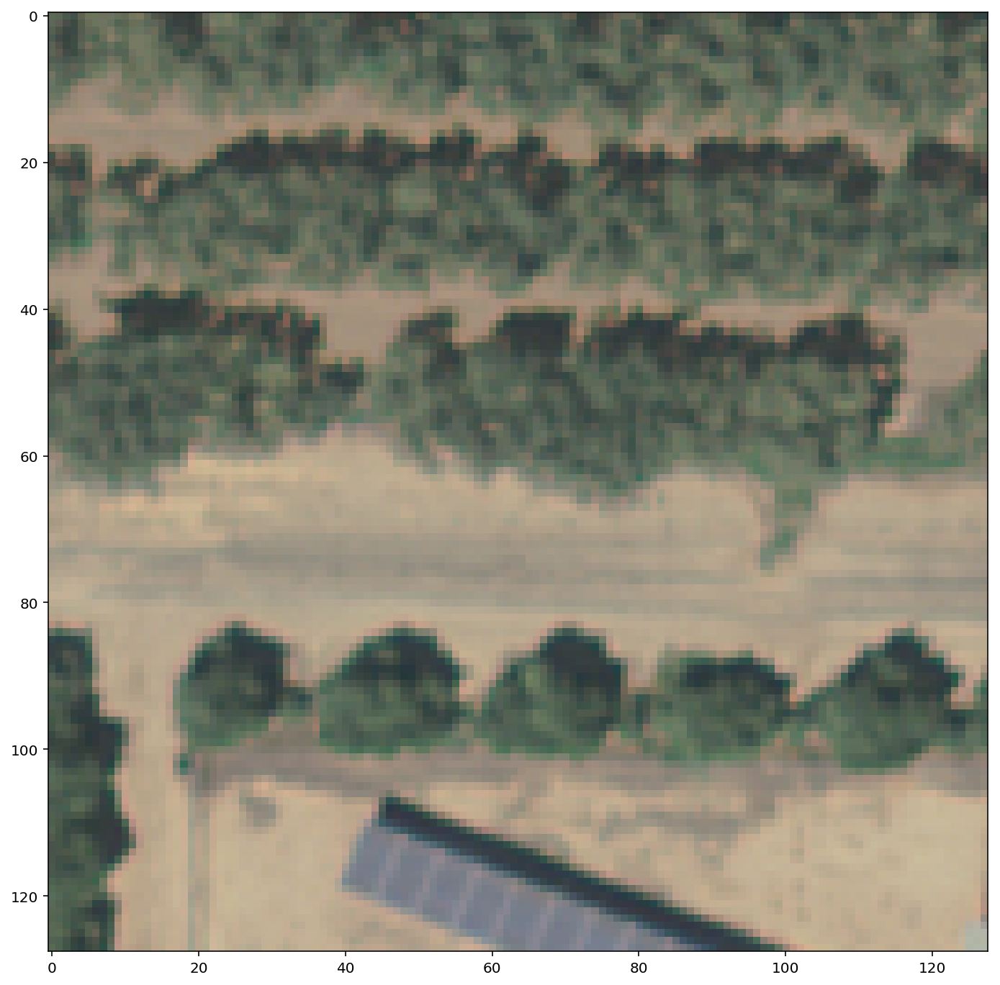

In [ ]:
for poly in poly_list[8:9]:
  create_X_train(poly)

In [ ]:
train_poly_list = arrays_clean[(arrays_clean['city'] == 'Fresno') | (arrays_clean['city'] == 'Modesto')]['polygon_id'].values
for poly in train_poly_list[:]:
  # X_train = create_X_train(poly)
  # np.save(('%s/%s.npy' % ("X_train_set", poly)), X_train)
  Y_train, Y_train2 = mask_centroids(poly)
  #np.save(('%s/%s.npy' % ("Y_train_set", poly)), Y_train)
  np.save(('%s/%s.npy' % ("Y_another_train_set", poly)), Y_train2)
  


In [ ]:
test_poly_list = arrays_clean[(arrays_clean['city'] == 'Oxnard') | (arrays_clean['city'] == 'Stockton')]['polygon_id'].values
for poly in test_poly_list[:]:
  # X_test = create_X_train(poly)
  # np.save(('%s/%s.npy' % ("X_test_set", poly)), X_test)
  Y_test, Y_test2 = mask_centroids(poly)
  # np.save(('%s/%s.npy' % ("Y_test_set", poly)), Y_test)
  np.save(('%s/%s.npy' % ("Y_another_test_set", poly)), Y_test2)